# H&M Fashion Recommendation

##### Business Problem

- H&M needs a fashion recommendation model to sustain the increased sales from their online channel post COVID19 pandemic.

##### Why do they need new model?

1. Sales dropped by 20% from 2019-2020​

2. Increased overhead cost for stores​

3. Extensive range of products for online shoppers​

4. Reducing footfall in brick-and-mortar stores​

##### Dataset 
- Data can be downloaded from here - https://www.kaggle.com/competitions/h-and-m-personalized-fashion-recommendations/data

##### My approach to solve the problem
- Identify insights through EDA
- Test out which clustering model works best to target appropriate customers

### Importing libraries 

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

### Loading the 3 datafiles into a dataframe

In [3]:
articles = pd.read_csv('articles.csv')
customers = pd.read_csv('customers.csv')
transaction = pd.read_csv('transactions_train.csv')

In [4]:
articles.head()

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,department_name,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,detail_desc
0,108775015,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,9,Black,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.
1,108775044,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,10,White,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.
2,108775051,108775,Strap top (1),253,Vest top,Garment Upper body,1010017,Stripe,11,Off White,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.
3,110065001,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,9,Black,...,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde..."
4,110065002,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,10,White,...,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde..."


In [5]:
customers.head()

,customer_id,FN,Active,club_member_status,fashion_news_frequency,age,postal_code
0,00000dbacae5abe5e23885899a1fa44253a17956c6d1c3...,NaN,NaN,ACTIVE,NONE,49.0,52043ee2162cf5aa7ee79974281641c6f11a68d276429a...
1,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,NaN,NaN,ACTIVE,NONE,25.0,2973abc54daa8a5f8ccfe9362140c63247c5eee03f1d93...
2,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,NaN,NaN,ACTIVE,NONE,24.0,64f17e6a330a85798e4998f62d0930d14db8db1c054af6...
3,00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2...,NaN,NaN,ACTIVE,NONE,54.0,5d36574f52495e81f019b680c843c443bd343d5ca5b1c2...
4,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,1.0,1.0,ACTIVE,Regularly,52.0,25fa5ddee9aac01b35208d01736e57942317d756b32ddd...


In [6]:
transaction.head()

,t_dat,customer_id,article_id,price,sales_channel_id
0,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,663713001,0.050831,2
1,2018-09-20,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,541518023,0.030492,2
2,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,505221004,0.015237,2
3,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,685687003,0.016932,2
4,2018-09-20,00007d2de826758b65a93dd24ce629ed66842531df6699...,685687004,0.016932,2


## Exploratory Data Analytics 

### EDA for articles 

In [7]:
# Check how many rows and columns articles data has
print(f"Dataframe articles has {len(articles)} rows and {len(articles.columns)} columns")

Dataframe articles has 105542 rows and 25 columns


### Which category of clothing is the most sold by H&M?

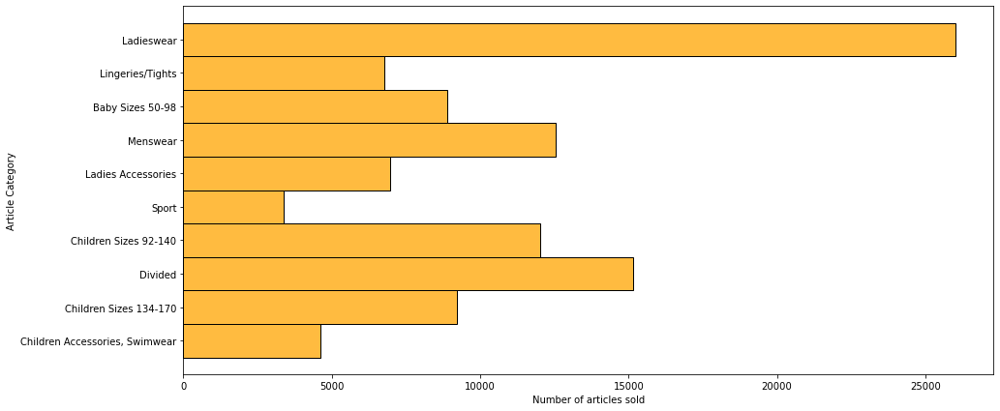

In [8]:
# Plotting a histogram to analyze the most sold products 
f, ax = plt.subplots(figsize=(15, 7))
ax = sns.histplot(data=articles, y='index_name', color='orange')
ax.set_xlabel('Number of articles sold')
ax.set_ylabel('Article Category')
plt.show()

From the above histogram, we see that ladieswear is the most sold category which has around 26000 of products sold followed by the divided category which has around 15,500 items sold. We also see that the sports category is the least sold at H&M. 

### EDA for Customers - Customer Analysis

In [9]:
# Check how many rows and columns customers data has
print(f"Dataframe customer has {len(customers)} rows and {len(customers.columns)} columns")

Dataframe customer has 1371980 rows and 7 columns


In order to perform the analysis, we first decided to create a new dataframe that will include, for each row, a unique customer_id, the total purchased quantity by that customer and the ernings generated by the company by the purchases of that customer.

First, we create a dataframe "cust_prices_df" which will include the unique customer ids and the earnings generated 
by theirs purchases.

In [10]:
cust_prices_df = transaction[["customer_id", "price"]].groupby("customer_id").sum()

In [11]:
cust_prices_df.head()

,price
customer_id,
00000dbacae5abe5e23885899a1fa44253a17956c6d1c3d25f88aa139fdfc657,0.648983
0000423b00ade91418cceaf3b26c6af3dd342b51fd051eec9c12fb36984420fa,2.601932
000058a12d5b43e67d225668fa1f8d618c13dc232df0cad8ffe7ad4a1091e318,0.704780
00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2c5feb1ca5dff07c43e,0.060983
00006413d8573cd20ed7128e53b7b13819fe5cfc2d801fe7fc0f26dd8d65a85a,0.469695


We create a dataframe "customer_qty_df" that will include the unique customer ids and their total purchased quantity of products.

In [12]:
customer_qty_df = transaction[["customer_id", "article_id"]].groupby("customer_id").count()

In [13]:
customer_qty_df.head()

,article_id
customer_id,
00000dbacae5abe5e23885899a1fa44253a17956c6d1c3d25f88aa139fdfc657,21
0000423b00ade91418cceaf3b26c6af3dd342b51fd051eec9c12fb36984420fa,86
000058a12d5b43e67d225668fa1f8d618c13dc232df0cad8ffe7ad4a1091e318,18
00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2c5feb1ca5dff07c43e,2
00006413d8573cd20ed7128e53b7b13819fe5cfc2d801fe7fc0f26dd8d65a85a,13


We then joined these two dataframe to a new one "cust_qty_price", which will include the unique customer ids, 
their purchased quantity and the earnings generated by the company by their purchases.

In [14]:
cust_qty_price = pd.merge(cust_prices_df, customer_qty_df, on='customer_id', how='inner')

In [15]:
cust_qty_price.head()

,price,article_id
customer_id,,
00000dbacae5abe5e23885899a1fa44253a17956c6d1c3d25f88aa139fdfc657,0.648983,21
0000423b00ade91418cceaf3b26c6af3dd342b51fd051eec9c12fb36984420fa,2.601932,86
000058a12d5b43e67d225668fa1f8d618c13dc232df0cad8ffe7ad4a1091e318,0.704780,18
00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2c5feb1ca5dff07c43e,0.060983,2
00006413d8573cd20ed7128e53b7b13819fe5cfc2d801fe7fc0f26dd8d65a85a,0.469695,13


In [16]:
cust_qty_price.shape

(1362281, 2)

Finally, we join this new dataframe to the Customer dataframe "customers", so that we can add some informations about the customer on the newly defined cust_qty_price dataframe.

In [17]:
cust_details = pd.merge(cust_qty_price, customers.drop("postal_code", axis=1), on='customer_id', how='inner')

In [18]:
cust_details.head()

,customer_id,price,article_id,FN,Active,club_member_status,fashion_news_frequency,age
0,00000dbacae5abe5e23885899a1fa44253a17956c6d1c3...,0.648983,21,NaN,NaN,ACTIVE,NONE,49.0
1,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,2.601932,86,NaN,NaN,ACTIVE,NONE,25.0
2,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,0.704780,18,NaN,NaN,ACTIVE,NONE,24.0
3,00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2...,0.060983,2,NaN,NaN,ACTIVE,NONE,54.0
4,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,0.469695,13,1.0,1.0,ACTIVE,Regularly,52.0


In [19]:
print(f"In total there are {len(cust_details)} different customers.")

In total there are 1362281 different customers.


### Which age group purchases more products?

In [20]:
# create a new column called age_groups and creare separate bins for age groups, based on their ages's.
cust_details['age_groups'] = pd.cut(cust_details['age'], bins=[16, 20, 30, 40, 50, 60, 70, float('Inf')], 
                                    labels=['16-20', '20-30','30-40','40-50','50-60','60-70' , '70+'])

In [21]:
cust_details.head()

,customer_id,price,article_id,FN,Active,club_member_status,fashion_news_frequency,age,age_groups
0,00000dbacae5abe5e23885899a1fa44253a17956c6d1c3...,0.648983,21,NaN,NaN,ACTIVE,NONE,49.0,40-50
1,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,2.601932,86,NaN,NaN,ACTIVE,NONE,25.0,20-30
2,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,0.704780,18,NaN,NaN,ACTIVE,NONE,24.0,20-30
3,00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2...,0.060983,2,NaN,NaN,ACTIVE,NONE,54.0,50-60
4,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,0.469695,13,1.0,1.0,ACTIVE,Regularly,52.0,50-60


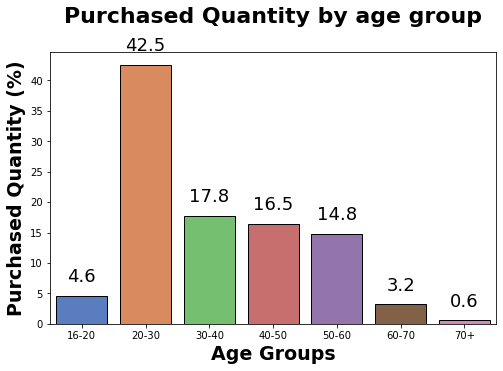

In [22]:
# plotting a bar chart of purchased quantity(%) by different age groups
plt.figure(figsize=(8,5))
plt.title("Purchased Quantity by age group\n", fontweight="bold", size = 22)
g = sns.barplot(x="age_groups", y="Purchased Quantity(%)", data=cust_details.groupby("age_groups")["article_id"].sum() \
            .transform(lambda x: (x / x.sum() * 100)).rename('Purchased Quantity(%)').reset_index(), palette = "muted", edgecolor = "black")
plt.xlabel("Age Groups",fontweight="bold", size = 19)
plt.ylabel("Purchased Quantity (%)",fontweight="bold", size = 19)
for container in g.containers:
    g.bar_label(container, padding = 10, fmt='%.1f', fontsize=18, color="black")
plt.show()

###### Insights:

1. Customers in the range 20-30 are responsible for more than 42% of the total purchased products.

2. Customers in the range 16-20, 60-70, and 70+ are responsible for 8% of the total purchased products.

3. Customers in the range 30-40, 40-50, and 50-60 are responsible for 16% of the total purchased products.

### Which age group generates more earnings for the company?

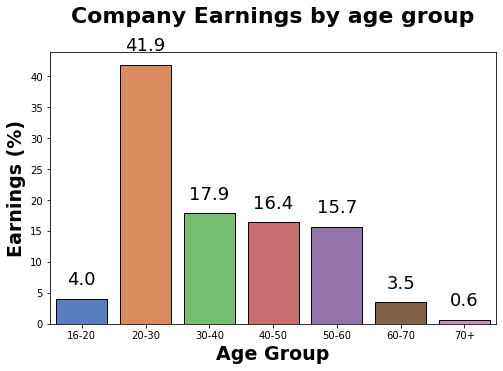

In [23]:
# plotting a bar chart of earnings(%) by different age groups 
plt.figure(figsize=(8,5))
plt.title("Company Earnings by age group\n", fontweight="bold", size = 22)
g = sns.barplot(x="age_groups", y="earning(%)", data=cust_details.groupby("age_groups")["price"].sum() \
            .transform(lambda x: (x / x.sum() * 100)).rename('earning(%)').reset_index(), palette = "muted",edgecolor = "black")
plt.xlabel("Age Group",fontweight="bold", size = 19)
plt.ylabel("Earnings (%)",fontweight="bold", size = 19)
for container in g.containers:
    g.bar_label(container, padding = 10, fmt='%.1f', fontsize=18, color="black")
plt.show()

###### Insights
Here from the above graph, we see a very similar situation in company earnings as to the purchase quantity analysis. Since the customers who buy more on average leads to higher earnings for the company. The age group 20-30 is by far mostly responsible for the highest earnings for the company which is a total of 41.9% of total earnings. 

### Do active customers on the fashion news purchase more articles?

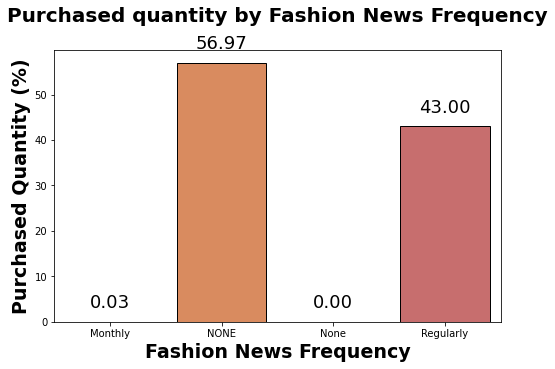

In [24]:
# plotting a bar chart of purchased quantity(%) by fashion news frequency 
plt.figure(figsize=(8,5))
plt.title("Purchased quantity by Fashion News Frequency\n", fontweight="bold", size = 20)
g = sns.barplot(x="fashion_news_frequency", y="Purchased Quantity(%)", data=cust_details.groupby("fashion_news_frequency")["article_id"].sum() \
            .transform(lambda x: (x / x.sum() * 100)).rename('Purchased Quantity(%)').reset_index(), palette = "muted", edgecolor = "black")
plt.xlabel("Fashion News Frequency",fontweight="bold", size = 19)
plt.ylabel("Purchased Quantity (%)",fontweight="bold", size = 19)
for container in g.containers:
    g.bar_label(container, padding = 10, fmt='%.2f', fontsize=18, color="black")
plt.show()

Active customers on the fashion news are responsible for 43% of the total purchases, while the remaining 57% of purchased quantity comes from customer not registed in the fashion news.

The other 2 categories "Monthly" and "None" can be ignored and won't be considered for the further analysis.

In [25]:
# So then it will be interesting to check the fashion news frequency by age group, to find more useful insights
x, y = 'age_groups', 'fashion_news_frequency'
df_age_news = cust_details.groupby(x)[y].value_counts(normalize=True)
df_age_news = df_age_news.mul(100)
df_age_news = df_age_news.rename('percent(%)').reset_index()
df_age_news = df_age_news[df_age_news["fashion_news_frequency"].isin(["Regularly","NONE"])]

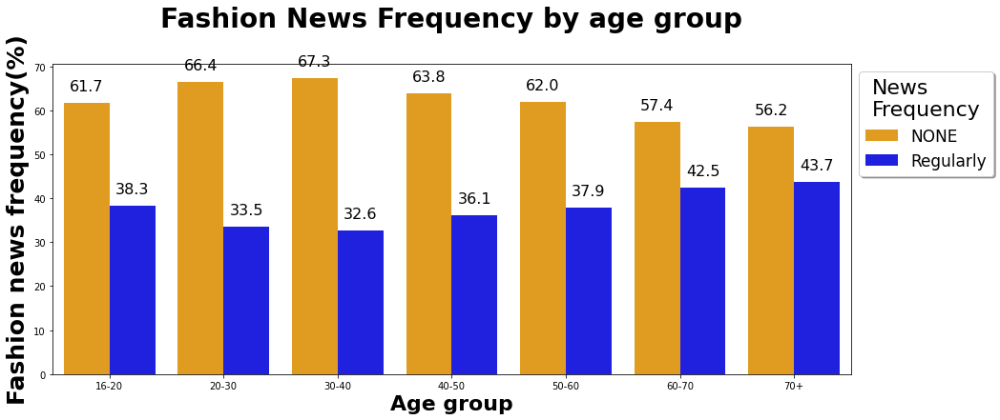

In [26]:
# plotting a bar chart of fashion news frequency(%) - none or regular by different age groups 
palette1 = {"Regularly":'blue', "NONE":'orange'}

plt.figure(figsize = (15,6))
plt.title("Fashion News Frequency by age group\n",fontweight="bold", size = 28)
g=sns.barplot(x="age_groups", y="percent(%)",data=df_age_news, hue="fashion_news_frequency", palette=palette1)
plt.xlabel("Age group",fontweight="bold", size=22)
plt.ylabel("Fashion news frequency(%)",fontweight="bold", size=25)
for container in g.containers:
    g.bar_label(container, padding = 10, fmt='%.1f', fontsize=16, color="black")
plt.legend(title='News\nFrequency',bbox_to_anchor=(1.0, 1.0), ncol=1, fancybox=True, shadow=True, fontsize=17,title_fontsize=22)
plt.show()

###### Insights:

We can see that customers in the age groups 20-30 and 30-40 have the lowest percentage of fashion news frequency, while being the groups which buy the most. Moreover, the frequency of customer that regulary check fashion news starts increasing from the range 40-50, with a peak value of 43.7% of regular/active users for customers in the range 70+ years old. This means that checking fashion news seems to be more effective for older customers, who still represent a small percentage of total sold products, while younger customers do not need to check the news to buy new products. It could be effective for the company to invite younger customers (age groups 20-40) to check the news more frequently in order to increase the sold items.

### EDA for Transactions - Transactional Analysis 

In [27]:
# import packages
from pandasql import sqldf
import plotly.express as px

In [28]:
# Check how many rows and columns transactions data has
print(f"Dataframe transactions has {len(transaction)} rows and {len(transaction.columns)} columns")

Dataframe transactions has 31788324 rows and 5 columns


In [29]:
# Check how many rows and columns articles data has
print(f"Dataframe articles has {len(articles)} rows and {len(articles.columns)} columns")

Dataframe articles has 105542 rows and 25 columns


In [30]:
# Select the article columns we think are useful
df_article = articles[['article_id', 'prod_name', 'product_type_name', 'product_group_name', 'colour_group_name', 'index_name']]
df_article.head()

,article_id,prod_name,product_type_name,product_group_name,colour_group_name,index_name
0,108775015,Strap top,Vest top,Garment Upper body,Black,Ladieswear
1,108775044,Strap top,Vest top,Garment Upper body,White,Ladieswear
2,108775051,Strap top (1),Vest top,Garment Upper body,Off White,Ladieswear
3,110065001,OP T-shirt (Idro),Bra,Underwear,Black,Lingeries/Tights
4,110065002,OP T-shirt (Idro),Bra,Underwear,White,Lingeries/Tights


In [31]:
# Select the transaction columns we think are useful
df_tran = transaction[['customer_id','article_id','price']]
df_tran.head()

,customer_id,article_id,price
0,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,663713001,0.050831
1,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,541518023,0.030492
2,00007d2de826758b65a93dd24ce629ed66842531df6699...,505221004,0.015237
3,00007d2de826758b65a93dd24ce629ed66842531df6699...,685687003,0.016932
4,00007d2de826758b65a93dd24ce629ed66842531df6699...,685687004,0.016932


In [32]:
df_soldquantity = df_tran['article_id'].value_counts()
df_soldquantity

706016001    50287
706016002    35043
372860001    31718
610776002    30199
759871002    26329
             ...  
520736002        1
619777003        1
586904003        1
512385003        1
533261032        1
Name: article_id, Length: 104547, dtype: int64

In [33]:
# Which product has the highest sold amount?
df_soldquantity = df_soldquantity.reset_index()
df_soldquantity = df_soldquantity.rename(columns={"article_id":"sold_qty","index":"article_id"})
df_soldquantity.head()

,article_id,sold_qty
0,706016001,50287
1,706016002,35043
2,372860001,31718
3,610776002,30199
4,759871002,26329


In [34]:
# Summary of sold_quantity
df_soldquantity['sold_qty'].describe()

count    104547.000000
mean        304.057735
std         791.266060
min           1.000000
25%          14.000000
50%          65.000000
75%         286.000000
max       50287.000000
Name: sold_qty, dtype: float64

1. There are 104547 different articles in the transcations
2. There are items only sold once
3. 25% of products have been sold less than 14 times
4. 75% of products have been sold less than 286 times
5. The most sold item have been sold 50287 times. 

### Which are the top 50 popular products in terms of their sold quantity?

In [35]:
# Select top 50 products that have the highest sold amount
top_50_sold = df_soldquantity.iloc[:50]
top_50_sold.head()

,article_id,sold_qty
0,706016001,50287
1,706016002,35043
2,372860001,31718
3,610776002,30199
4,759871002,26329


In [36]:
# Use SQL query to join the dataset
top_50_details = sqldf("""
                            SELECT * 
                            FROM top_50_sold AS t
                            INNER JOIN df_article AS a
                            ON t.article_id = a.article_id
                            """)

top_50_details.head()

,article_id,sold_qty,article_id,prod_name,product_type_name,product_group_name,colour_group_name,index_name
0,706016001,50287,706016001,Jade HW Skinny Denim TRS,Trousers,Garment Lower body,Black,Divided
1,706016002,35043,706016002,Jade HW Skinny Denim TRS,Trousers,Garment Lower body,Light Blue,Divided
2,372860001,31718,372860001,7p Basic Shaftless,Socks,Socks & Tights,Black,Lingeries/Tights
3,610776002,30199,610776002,Tilly (1),T-shirt,Garment Upper body,Black,Ladieswear
4,759871002,26329,759871002,Tilda tank,Vest top,Garment Upper body,Black,Divided


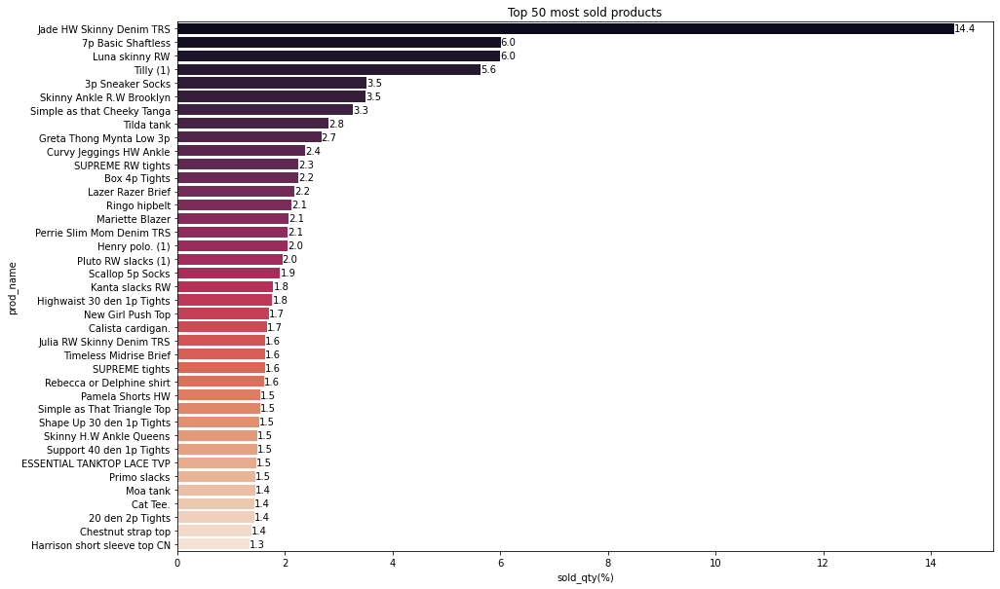

In [37]:
# Find the top 50 most sold products
# Plotting a bar chart of product name vs sold quantit
plt.figure(figsize=(15,10))
plt.title("Top 50 most sold products")
b=sns.barplot(y="prod_name",x="sold_qty(%)",data=top_50_details.groupby("prod_name")["sold_qty"].sum().transform(lambda x:(x/x.sum()*100)).rename('sold_qty(%)').reset_index().sort_values(by="sold_qty(%)",ascending=False),palette="rocket")
for container in b.containers:
    b.bar_label(container,fmt='%.1f',fontsize=10)
plt.show()

###### Insights
1. The trousers "Jade HW Skinny Denim TRS" is responsible for almost 15% of all sold products.
2. The top 6 of most sold items produce almost 40% of the top 50 sold products.

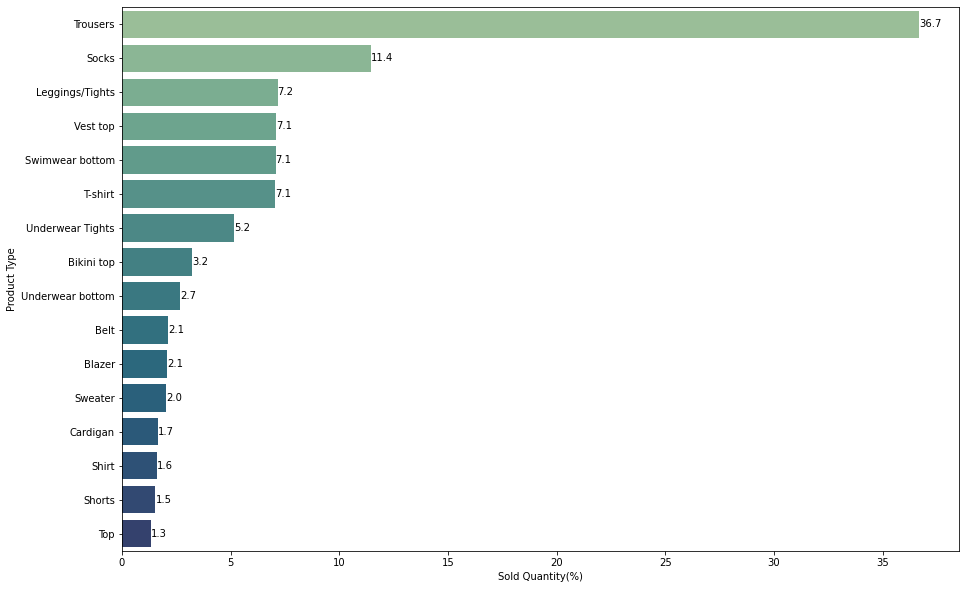

In [38]:
# We are trying to find the most popular type
# Plotting a bar chart of product type by sold quantity(%)
fig,ax = plt.subplots(figsize=(15,10))
b = sns.barplot(y="product_type_name",x="sold_qty(%)",data=top_50_details.groupby("product_type_name")["sold_qty"].sum().transform(lambda x:(x/x.sum()*100)).rename('sold_qty(%)').reset_index().sort_values(by="sold_qty(%)",ascending=False),palette="crest")
for container in b.containers:
    b.bar_label(container, fmt='%.1f',fontsize=10)
ax.set_xlabel("Sold Quantity(%)")
ax.set_ylabel("Product Type")
plt.show()

37% of sold products are trousers.

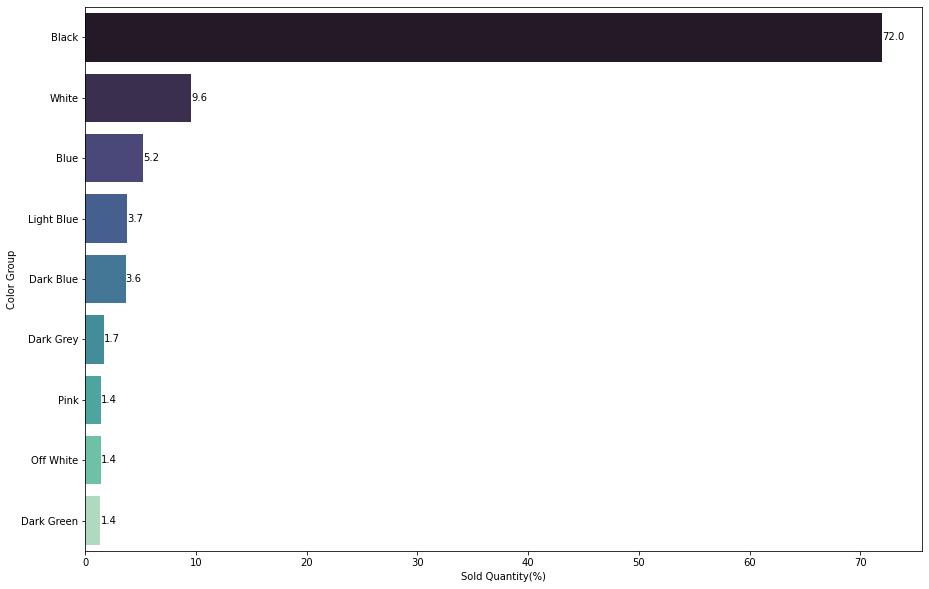

In [39]:
# We are going to find the most popular colour type
# Plotting a bar chart of color group vs sold quantity(%)
fig,ax = plt.subplots(figsize=(15,10))
b=sns.barplot(y="colour_group_name",x="sold_qty(%)",data=top_50_details.groupby("colour_group_name")["sold_qty"].sum().transform(lambda x:(x/x.sum()*100)).rename('sold_qty(%)').reset_index().sort_values(by="sold_qty(%)",ascending = False),palette="mako")
for container in b.containers:
    b.bar_label(container, fmt='%.1f',fontsize=10)
ax.set_xlabel("Sold Quantity(%)")
ax.set_ylabel("Color Group")
plt.show()

72% of sold products are black colored.

###  Which are the top 50 products that generated most earnings for the company?

In [40]:
# Select the specific column we need for analysis
df_price = df_tran[['price','article_id']].groupby('article_id').sum().sort_values(by="price",ascending=False)
df_price.rename(columns={'price':'earning'},inplace=True)
df_price = df_price.reset_index()

In [41]:
df_price.head()

,article_id,earning
0,706016001,1631.732102
1,706016002,1136.321085
2,568601006,939.268593
3,448509014,781.478390
4,706016003,692.195915


The most earning by a product is 1631. 

In [42]:
# Select the top 50 rows
top_50_price=df_price.iloc[:50]

In [43]:
# Use SQL query to join the dataset
top_50_price_detail = sqldf("""
                                SELECT * 
                                FROM top_50_price AS t
                                INNER JOIN df_article AS a
                                ON t.article_id = a.article_id
                                """)

top_50_price_detail.head()

,article_id,earning,article_id,prod_name,product_type_name,product_group_name,colour_group_name,index_name
0,706016001,1631.732102,706016001,Jade HW Skinny Denim TRS,Trousers,Garment Lower body,Black,Divided
1,706016002,1136.321085,706016002,Jade HW Skinny Denim TRS,Trousers,Garment Lower body,Light Blue,Divided
2,568601006,939.268593,568601006,Mariette Blazer,Blazer,Garment Upper body,Black,Ladieswear
3,448509014,781.478390,448509014,Perrie Slim Mom Denim TRS,Trousers,Garment Lower body,Blue,Divided
4,706016003,692.195915,706016003,Jade HW Skinny Denim TRS,Trousers,Garment Lower body,Dark Blue,Divided


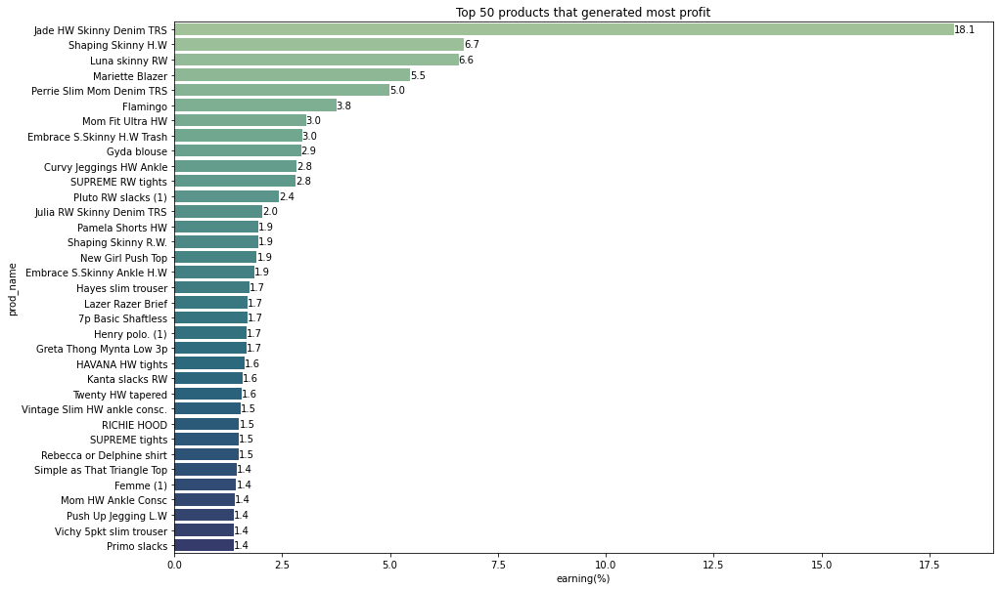

In [44]:
# We are trying to find which colour generated most profit
# Plotting a bar chart of Product Name vs the earnings(%)
plt.figure(figsize=(15,10))
plt.title("Top 50 products that generated most profit")
b=sns.barplot(y="prod_name",x="earning(%)",data=top_50_price_detail.groupby("prod_name")["earning"].sum().transform(lambda x:(x/x.sum()*100)).rename('earning(%)').reset_index().sort_values(by="earning(%)",ascending=False),palette="crest")
for container in b.containers:
    b.bar_label(container,fmt='%.1f')
plt.show()

We see that the "Jade HW Skinny Denim TRS" product generates the most profit for the company. 

### What product category generated least earning for the company?

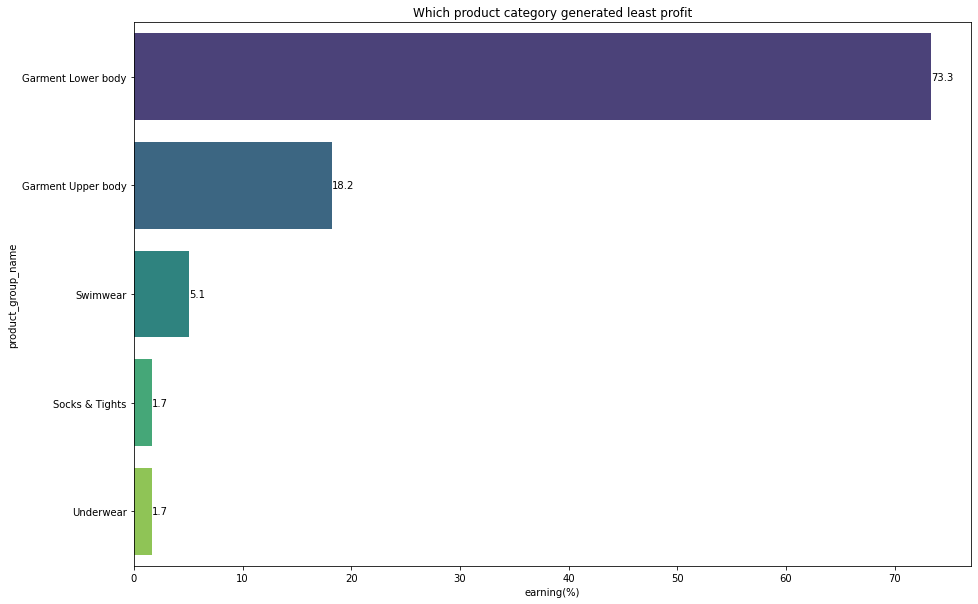

In [45]:
#We are trying to find which product category generated least profit
# Plotting a bar chart of the product group vs the earnings(%) 
plt.figure(figsize=(15,10))
plt.title("Which product category generated least profit")
b=sns.barplot(y="product_group_name",x="earning(%)",data=top_50_price_detail.groupby("product_group_name")["earning"].sum().transform(lambda x:(x/x.sum()*100)).rename('earning(%)').reset_index().sort_values(by="earning(%)",ascending=False),palette="viridis")
for container in b.containers:
    b.bar_label(container,fmt='%.1f')
plt.show()

Garment lower body generates the least profit for the company, only 1.7%

## Data Exploration/Preparation

In [46]:
# Check data product wise
pd.options.display.max_rows = None
articles.groupby(['product_group_name', 'product_type_name']).count()['article_id']

product_group_name     product_type_name       
Accessories            Accessories set                 7
                       Alice band                      6
                       Baby Bib                        3
                       Bag                          1280
                       Beanie                         56
                       Belt                          458
                       Bracelet                      180
                       Braces                          3
                       Bucket hat                      7
                       Cap                            13
                       Cap/peaked                    573
                       Dog Wear                       20
                       Earring                      1159
                       Earrings                       11
                       Eyeglasses                      2
                       Felt hat                       10
                       Giftbox          

In [47]:
# We filtered the transaction dataset from Sep 22, 2019 to Sep 22, 2020 so as to reduce the size of the dataset
filtered_trans = transaction.loc[(transaction['t_dat'] >= '2019-09-22')
                     & (transaction['t_dat'] < '2020-09-22')]

In [48]:
# joining the filtered transaction data with articles on the article_id
trans_join_article = filtered_trans.merge(articles,on='article_id',how='left')

In [49]:
trans_join_article.shape

(14899507, 29)

In [50]:
# joining the previously joined transaction and article dataset with customers on customer_id
trans_join_article_customer = trans_join_article.merge(customers, on='customer_id', how='left')

In [51]:
trans_join_article_customer.head()

,t_dat,customer_id,article_id,price,sales_channel_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,...,section_name,garment_group_no,garment_group_name,detail_desc,FN,Active,club_member_status,fashion_news_frequency,age,postal_code
0,2019-09-22,000fb6e772c5d0023892065e659963da90b1866035558e...,695632095,0.033881,2,695632,Gyda- (1),258,Blouse,Garment Upper body,...,Womens Tailoring,1010,Blouses,"Blouse in a soft weave with a narrow collar, c...",1.0,1.0,ACTIVE,Regularly,42.0,68ca4d9d6051d9c10b917d36bf9cb4afbadc551f7e4feb...
1,2019-09-22,0014b19aa47d031d859ae8d8f776524cdd35349db69d64...,787648001,0.016932,2,787648,JOY THIN SCARF NEW,80,Scarf,Accessories,...,Divided Accessories,1019,Accessories,"Scarf in a soft, thin weave with fringed trims.",NaN,NaN,ACTIVE,NONE,59.0,4917dfbc910f546bbcd6085780e3c87ef8fbf8d3844da1...
2,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,767496001,0.015237,1,767496,LOGG Westeros skirt,275,Skirt,Garment Lower body,...,H&M+,1009,Trousers,Calf-length skirt in woven fabric with a high ...,NaN,NaN,ACTIVE,NONE,62.0,d73085acc108331bf03eab30052ae9401f61eb5b555966...
3,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,766826002,0.050831,1,766826,Amalfi skirt,275,Skirt,Garment Lower body,...,Womens Tailoring,1012,Skirts,Knee-length skirt in lightweight cotton twill....,NaN,NaN,ACTIVE,NONE,62.0,d73085acc108331bf03eab30052ae9401f61eb5b555966...
4,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,655710010,0.050831,1,655710,Cher skirt,275,Skirt,Garment Lower body,...,Womens Tailoring,1012,Skirts,"Knee-length, pattern-weave skirt with a concea...",NaN,NaN,ACTIVE,NONE,62.0,d73085acc108331bf03eab30052ae9401f61eb5b555966...


In [52]:
# Handling missing values in age column by taking the mean in trans_join_article_customer
mean = trans_join_article_customer['age'].mean()
trans_join_article_customer['age'].fillna(value=mean, inplace=True)

In [53]:
# Handling missing values in FN and Active column with 0
trans_join_article_customer['FN']= trans_join_article_customer['FN'].fillna(0)
trans_join_article_customer['Active']= trans_join_article_customer['Active'].fillna(0)

In [54]:
# Converting club member status and fashion news frequency columns into categorical variables
club_member_status_n = pd.get_dummies(trans_join_article_customer['club_member_status'],drop_first=True)
fashion_news_frequency_n = pd.get_dummies(trans_join_article_customer['fashion_news_frequency'],drop_first=True)

In [55]:
# Drop the columns on club_member_status, fashion_news_frequency and detail_desc
trans_join_article_customer.drop(['club_member_status','fashion_news_frequency','detail_desc'],axis=1,inplace=True)

In [56]:
# Concatenating the joined data with the categorical variables
trans_join_article_customer = pd.concat([trans_join_article_customer,club_member_status_n,fashion_news_frequency_n], 
                                        axis=1)

In [57]:
trans_join_article_customer.head() 

,t_dat,customer_id,article_id,price,sales_channel_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,...,garment_group_name,FN,Active,age,postal_code,LEFT CLUB,PRE-CREATE,NONE,None,Regularly
0,2019-09-22,000fb6e772c5d0023892065e659963da90b1866035558e...,695632095,0.033881,2,695632,Gyda- (1),258,Blouse,Garment Upper body,...,Blouses,1.0,1.0,42.0,68ca4d9d6051d9c10b917d36bf9cb4afbadc551f7e4feb...,0,0,0,0,1
1,2019-09-22,0014b19aa47d031d859ae8d8f776524cdd35349db69d64...,787648001,0.016932,2,787648,JOY THIN SCARF NEW,80,Scarf,Accessories,...,Accessories,0.0,0.0,59.0,4917dfbc910f546bbcd6085780e3c87ef8fbf8d3844da1...,0,0,1,0,0
2,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,767496001,0.015237,1,767496,LOGG Westeros skirt,275,Skirt,Garment Lower body,...,Trousers,0.0,0.0,62.0,d73085acc108331bf03eab30052ae9401f61eb5b555966...,0,0,1,0,0
3,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,766826002,0.050831,1,766826,Amalfi skirt,275,Skirt,Garment Lower body,...,Skirts,0.0,0.0,62.0,d73085acc108331bf03eab30052ae9401f61eb5b555966...,0,0,1,0,0
4,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,655710010,0.050831,1,655710,Cher skirt,275,Skirt,Garment Lower body,...,Skirts,0.0,0.0,62.0,d73085acc108331bf03eab30052ae9401f61eb5b555966...,0,0,1,0,0


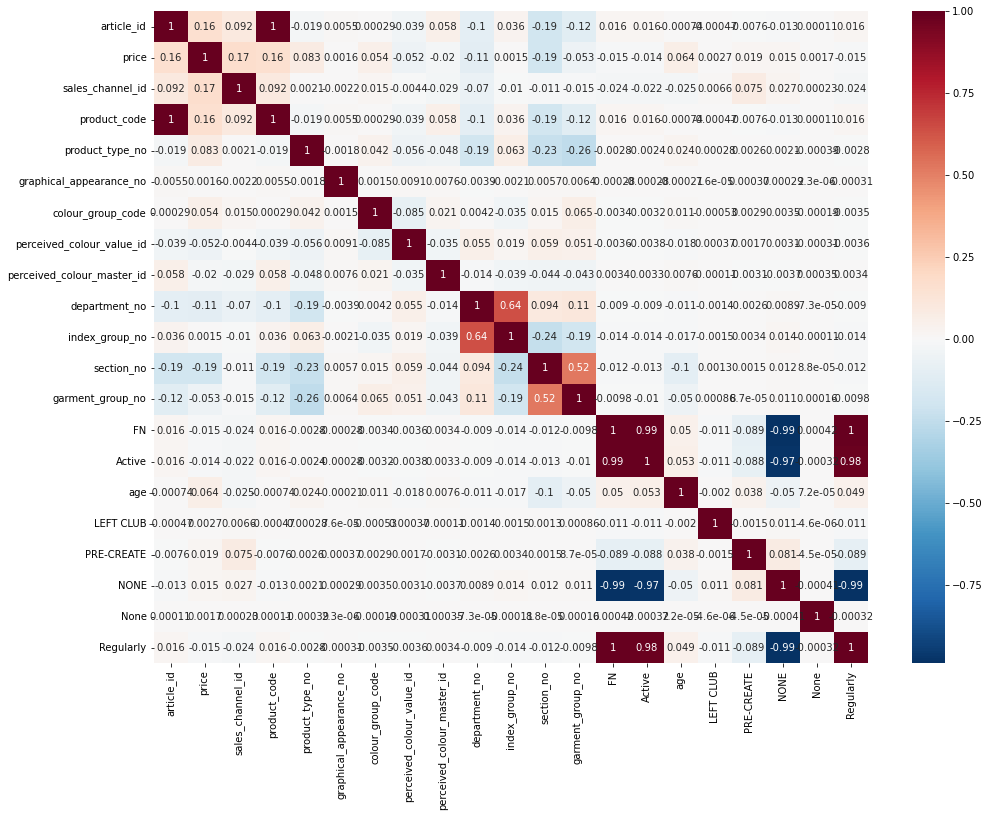

In [58]:
# created a correlation matrix to understand which variables are highly correlated 
corr = trans_join_article_customer.corr()
fig, ax = plt.subplots()
fig.set_size_inches(16, 12)
sns.heatmap(corr, annot=True, cmap="RdBu_r", center=0, ax=ax)
plt.show()

# Methodology

## Kmeans Clustering 

### Data Preparation for Clustering

In [59]:
# importing required packages
import sys, warnings, time, os, copy, gc, re, random, pickle
warnings.filterwarnings('ignore')
from IPython.display import display
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
sns.set()
from pandas.io.json import json_normalize
from pprint import pprint
from pathlib import Path
from tqdm import tqdm
tqdm.pandas()
from collections import Counter
from datetime import datetime, timedelta
from sklearn.cluster import KMeans
from sklearn import preprocessing
import plotly.express as ex
from sklearn.decomposition import PCA

In [60]:
# select 3 columns from transaction data - date, customer_id and article_id, and store into a new dataframe
transtrain_n = transaction[['t_dat','customer_id','article_id']]

# filter the transaction data to only filter 1 year of data from Sep 22, 2019 to Sep 22, 2020
transtrain_n = transaction.loc[(transaction['t_dat'] >= '2019-09-22')
                     & (transaction['t_dat'] < '2020-09-22')]

In [61]:
print(transtrain_n.shape)
transtrain_n.head()

(14899507, 5)


,t_dat,customer_id,article_id,price,sales_channel_id
16855951,2019-09-22,000fb6e772c5d0023892065e659963da90b1866035558e...,695632095,0.033881,2
16855952,2019-09-22,0014b19aa47d031d859ae8d8f776524cdd35349db69d64...,787648001,0.016932,2
16855953,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,767496001,0.015237,1
16855954,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,766826002,0.050831,1
16855955,2019-09-22,0023f9e96ae935c11bc2c950f317b73facea404dde95a3...,655710010,0.050831,1


Grouping transaction data in order to get the count of every item that has been sold

In [62]:
# create a new dataframe called product_bought_times  
product_bought_times = transtrain_n.groupby(['customer_id','article_id'])['t_dat'].agg('count').reset_index()
product_bought_times.columns = ['customer_id','article_id','ct']
product_bought_times.tail()

,customer_id,article_id,ct
12878150,ffffd7744cebcf3aca44ae7049d2a94b87074c3d4ffe38...,821395003,1
12878151,ffffd7744cebcf3aca44ae7049d2a94b87074c3d4ffe38...,840360003,1
12878152,ffffd7744cebcf3aca44ae7049d2a94b87074c3d4ffe38...,866755002,2
12878153,ffffd7744cebcf3aca44ae7049d2a94b87074c3d4ffe38...,882810001,1
12878154,ffffd9ac14e89946416d80e791d064701994755c3ab686...,806050001,1


In [63]:
# merge transaction train dataframe on product_bought_time dataframe on customer_id and article_id 
transtrain_n = transtrain_n.merge(product_bought_times,on=['customer_id','article_id'],how='left')
transtrain_n  = transtrain_n.sort_values(['ct','t_dat'],ascending=False)
transtrain_n  = transtrain_n.drop_duplicates(['customer_id','article_id'])
transtrain_n.tail()

,t_dat,customer_id,article_id,price,sales_channel_id,ct
33944,2019-09-22,ffe8f09992a6e188390e34872208dd23ebb6425957cc64...,772829002,0.133102,2,1
33945,2019-09-22,fff88e9edfb6987b82fad36c1270082bc101be633efd0a...,817869001,0.025407,2,1
33947,2019-09-22,fffbe76d05cba1b9bdf14bf67e58e7b73d4c2e3418f13c...,715624036,0.025407,2,1
33948,2019-09-22,fffbe76d05cba1b9bdf14bf67e58e7b73d4c2e3418f13c...,456163051,0.033881,2,1
33949,2019-09-22,fffcd556af797bddc25d6d56600b6e298a19b90624a8ee...,773989001,0.050831,2,1


In [64]:
# Check transtrain_n data types for each column
transtrain_n.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12878155 entries, 291434 to 33949
Data columns (total 6 columns):
 #   Column            Dtype  
---  ------            -----  
 0   t_dat             object 
 1   customer_id       object 
 2   article_id        int64  
 3   price             float64
 4   sales_channel_id  int64  
 5   ct                int64  
dtypes: float64(1), int64(3), object(2)
memory usage: 687.8+ MB


In [65]:
# convert t_dat from dataframe object to date_time pd series
transtrain_n['t_dat'] = pd.to_datetime(transtrain_n['t_dat'], errors='coerce')

In [66]:
# convert t_dat columns separated down to year, month, day
# utilize pd.series_dt to aggregate to day of week, day of year 
# Drop the t_dat in the end since we seperated down all the columns
transtrain_n['year'] = transtrain_n['t_dat'].dt.year
transtrain_n['month'] = transtrain_n['t_dat'].dt.month
transtrain_n['day'] = transtrain_n['t_dat'].dt.day
transtrain_n['dayofweek'] = transtrain_n['t_dat'].dt.dayofweek
transtrain_n['dayofyear'] = transtrain_n['t_dat'].dt.dayofyear
transtrain_n['is_month_end'] = transtrain_n['t_dat'].dt.is_month_end
transtrain_n['is_month_start'] = transtrain_n['t_dat'].dt.is_month_start
transtrain_n.drop(columns=['t_dat'], inplace = True)

transtrain_n.tail()

,customer_id,article_id,price,sales_channel_id,ct,year,month,day,dayofweek,dayofyear,is_month_end,is_month_start
33944,ffe8f09992a6e188390e34872208dd23ebb6425957cc64...,772829002,0.133102,2,1,2019,9,22,6,265,False,False
33945,fff88e9edfb6987b82fad36c1270082bc101be633efd0a...,817869001,0.025407,2,1,2019,9,22,6,265,False,False
33947,fffbe76d05cba1b9bdf14bf67e58e7b73d4c2e3418f13c...,715624036,0.025407,2,1,2019,9,22,6,265,False,False
33948,fffbe76d05cba1b9bdf14bf67e58e7b73d4c2e3418f13c...,456163051,0.033881,2,1,2019,9,22,6,265,False,False
33949,fffcd556af797bddc25d6d56600b6e298a19b90624a8ee...,773989001,0.050831,2,1,2019,9,22,6,265,False,False


In [67]:
# convert customer_id to categorical data type 
# use pd.series.cat.codes function to give every customer a unique category code
# save it as customer_category_df
transtrain_n['customer_category'] = transtrain_n['customer_id'].astype('category')
transtrain_n['category_codes'] = transtrain_n['customer_category'].cat.codes 
customer_category_df = transtrain_n[['customer_id', 'customer_category', 'category_codes']] #save them to put them back together later
print(customer_category_df.dtypes)
customer_category_df.head()

customer_id            object
customer_category    category
category_codes          int32
dtype: object


,customer_id,customer_category,category_codes
291434,5cba04ed9a3759bc02a8a9e01efccc07ce76c35c1a70dc...,5cba04ed9a3759bc02a8a9e01efccc07ce76c35c1a70dc...,359965
1102353,0152964ef19824d631d28ee3327a010fbfc528cdaf5bf0...,0152964ef19824d631d28ee3327a010fbfc528cdaf5bf0...,5115
5266610,c163adbcac6e42e600224be5e1682a5b840e1d430c443a...,c163adbcac6e42e600224be5e1682a5b840e1d430c443a...,750667
6240939,1472c551f2c04873edddc853e214a033692b2b1d6ae2bb...,1472c551f2c04873edddc853e214a033692b2b1d6ae2bb...,79474
11819500,8d70381b62a1d3e6d057a6d006ea52f65aded5c3657335...,8d70381b62a1d3e6d057a6d006ea52f65aded5c3657335...,548908


In [68]:
# Check category_code
customer_category_df[customer_category_df['category_codes'] == 548908]

,customer_id,customer_category,category_codes
11819500,8d70381b62a1d3e6d057a6d006ea52f65aded5c3657335...,8d70381b62a1d3e6d057a6d006ea52f65aded5c3657335...,548908


In [69]:
# As we have created a new dataframe for customer_category,
# we can now drop the two columns - customer_category & category_codes in transtrain_n
transtrain_n.drop(columns=['customer_category', 'category_codes'], inplace = True)
transtrain_n.dtypes

customer_id          object
article_id            int64
price               float64
sales_channel_id      int64
ct                    int64
year                  int64
month                 int64
day                   int64
dayofweek             int64
dayofyear             int64
is_month_end           bool
is_month_start         bool
dtype: object

In [70]:
transtrain_n.head(10)

,customer_id,article_id,price,sales_channel_id,ct,year,month,day,dayofweek,dayofyear,is_month_end,is_month_start
291434,5cba04ed9a3759bc02a8a9e01efccc07ce76c35c1a70dc...,688558002,0.013661,2,166,2019,9,28,5,271,False,False
1102353,0152964ef19824d631d28ee3327a010fbfc528cdaf5bf0...,756322001,0.025407,2,120,2019,10,16,2,289,False,False
5266610,c163adbcac6e42e600224be5e1682a5b840e1d430c443a...,689365047,0.025407,2,114,2020,2,7,4,38,False,False
6240939,1472c551f2c04873edddc853e214a033692b2b1d6ae2bb...,852521001,0.033881,2,81,2020,3,6,4,66,False,False
11819500,8d70381b62a1d3e6d057a6d006ea52f65aded5c3657335...,685813001,0.016932,2,80,2020,7,6,0,188,False,False
3134723,006d4d3564072c27710509891093efa1324be6aaef0de3...,727880001,0.016932,2,78,2019,12,10,1,344,False,False
10789956,91f3ab5944411eb3f6f79e93ab430f3d4ff92e5a5d4475...,189634001,0.002695,1,77,2020,6,20,5,172,False,False
5493551,8de98d98789e2d90eb7d8b3b631e0a7d895aba860124a2...,828047002,0.013542,2,76,2020,2,14,4,45,False,False
4792909,a77ced28f1ca69f3a154cee61b42bbf4933ed483f1d515...,685816002,0.008458,2,76,2020,1,25,5,25,False,False
13833078,9f2b4a44d60839053860ef9035317120c992287b78c9fb...,751471042,0.033881,2,75,2020,8,24,0,237,False,False


### Merging articles with "ct" columns from transaction data (transtrain_n) as one of the kmeans feature

In [71]:
# Drop column "detail_desc" from the articles table 
articles.drop(columns=['detail_desc'], inplace = True)

In [72]:
articles.shape

(105542, 24)

In [73]:
# Show articles dataframe data types 
articles.dtypes

article_id                       int64
product_code                     int64
prod_name                       object
product_type_no                  int64
product_type_name               object
product_group_name              object
graphical_appearance_no          int64
graphical_appearance_name       object
colour_group_code                int64
colour_group_name               object
perceived_colour_value_id        int64
perceived_colour_value_name     object
perceived_colour_master_id       int64
perceived_colour_master_name    object
department_no                    int64
department_name                 object
index_code                      object
index_name                      object
index_group_no                   int64
index_group_name                object
section_no                       int64
section_name                    object
garment_group_no                 int64
garment_group_name              object
dtype: object

In [74]:
# create a dataframe called time_bought and subset it to just contain two columns - article_id and ct 
times_bought = transtrain_n[['article_id', 'ct']]

# group by the times_bought dataframe by article_id
times_bought = times_bought.groupby('article_id', as_index = False).sum()
times_bought.head()

,article_id,ct
0,108775015,103
1,108775044,423
2,110065001,155
3,110065002,65
4,110065011,100


In [75]:
# left join the articles data with times_bought on article_id
articles = articles.merge(times_bought, how='left', on='article_id')

# handling missing values in ct column with 0
articles['ct'] = articles['ct'].fillna(0)
articles.head()

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,department_name,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,ct
0,108775015,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,9,Black,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,103.0
1,108775044,108775,Strap top,253,Vest top,Garment Upper body,1010016,Solid,10,White,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,423.0
2,108775051,108775,Strap top (1),253,Vest top,Garment Upper body,1010017,Stripe,11,Off White,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,0.0
3,110065001,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,9,Black,...,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear",155.0
4,110065002,110065,OP T-shirt (Idro),306,Bra,Underwear,1010016,Solid,10,White,...,Clean Lingerie,B,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear",65.0


In [76]:
# kmeans can't handle integers, so converting them to float
int64s = articles.select_dtypes(include=['int64']).columns
for i in int64s:
    articles[i] = articles[i].astype(float)

In [77]:
articles.head()

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,department_name,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,ct
0,108775015.0,108775.0,Strap top,253.0,Vest top,Garment Upper body,1010016.0,Solid,9.0,Black,...,Jersey Basic,A,Ladieswear,1.0,Ladieswear,16.0,Womens Everyday Basics,1002.0,Jersey Basic,103.0
1,108775044.0,108775.0,Strap top,253.0,Vest top,Garment Upper body,1010016.0,Solid,10.0,White,...,Jersey Basic,A,Ladieswear,1.0,Ladieswear,16.0,Womens Everyday Basics,1002.0,Jersey Basic,423.0
2,108775051.0,108775.0,Strap top (1),253.0,Vest top,Garment Upper body,1010017.0,Stripe,11.0,Off White,...,Jersey Basic,A,Ladieswear,1.0,Ladieswear,16.0,Womens Everyday Basics,1002.0,Jersey Basic,0.0
3,110065001.0,110065.0,OP T-shirt (Idro),306.0,Bra,Underwear,1010016.0,Solid,9.0,Black,...,Clean Lingerie,B,Lingeries/Tights,1.0,Ladieswear,61.0,Womens Lingerie,1017.0,"Under-, Nightwear",155.0
4,110065002.0,110065.0,OP T-shirt (Idro),306.0,Bra,Underwear,1010016.0,Solid,10.0,White,...,Clean Lingerie,B,Lingeries/Tights,1.0,Ladieswear,61.0,Womens Lingerie,1017.0,"Under-, Nightwear",65.0


In [78]:
articles.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 105542 entries, 0 to 105541
Data columns (total 25 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   article_id                    105542 non-null  float64
 1   product_code                  105542 non-null  float64
 2   prod_name                     105542 non-null  object 
 3   product_type_no               105542 non-null  float64
 4   product_type_name             105542 non-null  object 
 5   product_group_name            105542 non-null  object 
 6   graphical_appearance_no       105542 non-null  float64
 7   graphical_appearance_name     105542 non-null  object 
 8   colour_group_code             105542 non-null  float64
 9   colour_group_name             105542 non-null  object 
 10  perceived_colour_value_id     105542 non-null  float64
 11  perceived_colour_value_name   105542 non-null  object 
 12  perceived_colour_master_id    105542 non-nul

In [79]:
articles.select_dtypes(include=['object']).columns

Index(['prod_name', 'product_type_name', 'product_group_name',
       'graphical_appearance_name', 'colour_group_name',
       'perceived_colour_value_name', 'perceived_colour_master_name',
       'department_name', 'index_code', 'index_name', 'index_group_name',
       'section_name', 'garment_group_name'],
      dtype='object')

In [80]:
le = preprocessing.LabelEncoder()

# fit label encorder and return encoded integer labels for categorical string features for the following columns
articles['prod_name'] = le.fit_transform(articles['prod_name'].values)
articles['product_type_name'] = le.fit_transform(articles['product_type_name'].values)
articles['product_group_name'] = le.fit_transform(articles['product_group_name'].values)
articles['graphical_appearance_name'] = le.fit_transform(articles['graphical_appearance_name'].values)
articles['colour_group_name'] = le.fit_transform(articles['colour_group_name'].values)
articles['perceived_colour_value_name'] = le.fit_transform(articles['perceived_colour_value_name'].values)
articles['perceived_colour_master_name'] = le.fit_transform(articles['perceived_colour_master_name'].values)
articles['department_name'] = le.fit_transform(articles['department_name'].values)
articles['index_code'] = le.fit_transform(articles['index_code'].values)
articles['index_name'] = le.fit_transform(articles['index_name'].values)
articles['index_group_name'] = le.fit_transform(articles['index_group_name'].values)
articles['section_name'] = le.fit_transform(articles['section_name'].values)
articles['garment_group_name'] = le.fit_transform(articles['garment_group_name'].values)


### K-means Clustering on articles dataset

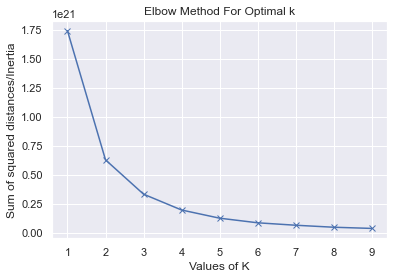

In [81]:
# running the elbow method to choose the optimal k(number of clusters)
Sum_of_squared_distances = []
K = range(1, 10)
for num_clusters in K :
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(articles)
    Sum_of_squared_distances.append(kmeans.inertia_)
plt.plot(K,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Elbow Method For Optimal k')
plt.show()

After running the elbow method above, we see that 4 is the optimal number of clusters as the inertia begins to decrease more slowly at 4. 

In [82]:
# running KMeans with 4 clusters
kmeans_float = KMeans(n_clusters=4)
kmeans_fit = kmeans_float.fit(articles)

In [83]:
print("labels:")
print(kmeans_float.labels_)
print("cluster_centers:")
print(kmeans_float.cluster_centers_)

labels:
[2 2 2 ... 1 1 1]
cluster_centers:
[[7.10886083e+08 7.10886078e+05 2.32609799e+04 2.32933352e+02
  7.33748988e+01 6.95510421e+00 1.00914378e+06 1.64340348e+01
  3.23570923e+01 1.73572187e+01 3.22473189e+00 2.11468029e+00
  7.86328915e+00 6.84887191e+00 4.65690492e+03 1.20510775e+02
  3.56523169e+00 4.52041178e+00 3.15294921e+00 1.33235532e+00
  4.30517756e+01 2.81701234e+01 1.01043277e+03 8.43962465e+00
  1.16242159e+02]
 [8.44554062e+08 8.44554059e+05 2.26226705e+04 2.33312409e+02
  7.00663627e+01 6.61996701e+00 1.01001295e+06 1.73589470e+01
  2.94663174e+01 1.71160700e+01 3.09149122e+00 2.14288024e+00
  7.89275897e+00 6.76621067e+00 4.20925698e+03 1.17498658e+02
  3.13783513e+00 4.62941043e+00 2.93884415e+00 1.39946962e+00
  4.13596908e+01 2.99695676e+01 1.01044303e+03 7.90660069e+00
  2.59979140e+02]
 [3.67091317e+08 3.67091298e+05 2.29179321e+04 2.35480160e+02
  8.16828051e+01 7.44222610e+00 1.00950917e+06 1.78891939e+01
  3.33603694e+01 1.66613427e+01 3.24706763e+00 2.0960

In [84]:
# predicting the articles and putting them to the associated clusters
kmeans_float.fit_predict(articles)

array([3, 3, 3, ..., 0, 0, 0], dtype=int32)

In [85]:
labels = kmeans_float.labels_

# glue back to original data
articles['clusters'] = labels

In [86]:
# count the number of articles in each cluster
articles.clusters.value_counts()

2    39595
1    31117
0    30817
3     4013
Name: clusters, dtype: int64

In [87]:
articles.tail()

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,ct,clusters
105537,953450001.0,953450.0,796,302.0,95,13,1010014.0,22,9.0,1,...,4,8,3.0,3,26.0,38,1021.0,13,16.0,0
105538,953763001.0,953763.0,37624,253.0,121,7,1010016.0,25,9.0,1,...,0,6,1.0,2,2.0,18,1005.0,6,34.0,0
105539,956217002.0,956217.0,8256,265.0,32,5,1010016.0,25,9.0,1,...,0,6,1.0,2,18.0,53,1005.0,6,21.0,0
105540,957375001.0,957375.0,6953,72.0,45,0,1010016.0,25,9.0,1,...,3,4,2.0,1,52.0,9,1019.0,0,0.0,0
105541,959461001.0,959461.0,25218,265.0,32,5,1010016.0,25,11.0,29,...,0,6,1.0,2,18.0,53,1005.0,6,0.0,0


In [88]:
# checking about cluster 2
articles[articles['clusters']==2].head()

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,ct,clusters
35130,645595001.0,645595.0,35066,262.0,56,7,1010004.0,4,93.0,6,...,4,8,3.0,3,31.0,39,1007.0,8,0.0,2
35131,645599001.0,645599.0,26487,272.0,112,6,1010023.0,7,73.0,5,...,5,0,4.0,0,40.0,2,1006.0,20,2.0,2
35132,645604001.0,645604.0,23928,272.0,112,6,1010023.0,7,71.0,20,...,5,0,4.0,0,40.0,2,1006.0,20,0.0,2
35133,645604002.0,645604.0,23928,272.0,112,6,1010023.0,7,9.0,1,...,5,0,4.0,0,40.0,2,1006.0,20,1.0,2
35134,645606001.0,645606.0,36119,270.0,42,5,1010016.0,25,9.0,1,...,6,3,4.0,0,45.0,24,1007.0,8,0.0,2


In [89]:
# running the pca for dimension reduction 
pca = PCA(n_components=3)
articles_reduced = pca.fit_transform(articles)
articles_reduced

array([[ 5.89649849e+08, -1.19303554e+03, -1.60256729e+04],
       [ 5.89649820e+08, -1.19306900e+03, -1.60258886e+04],
       [ 5.89649813e+08, -1.19401597e+03, -1.60266103e+04],
       ...,
       [-2.57792562e+08, -2.57361014e+02,  1.42873457e+04],
       [-2.58950561e+08, -2.66403958e+02,  1.55919606e+04],
       [-2.61036562e+08, -1.15022650e+02, -2.68243551e+03]])

In [90]:
# plotting a 3D scatter plot 
fig=px.scatter_3d(articles_reduced,x=0,y=1,z=2,color=labels)
fig.show()

### Data Preparation for Predictive Analysis

In [91]:
customers.head(10)

,customer_id,FN,Active,club_member_status,fashion_news_frequency,age,postal_code
0,00000dbacae5abe5e23885899a1fa44253a17956c6d1c3...,NaN,NaN,ACTIVE,NONE,49.0,52043ee2162cf5aa7ee79974281641c6f11a68d276429a...
1,0000423b00ade91418cceaf3b26c6af3dd342b51fd051e...,NaN,NaN,ACTIVE,NONE,25.0,2973abc54daa8a5f8ccfe9362140c63247c5eee03f1d93...
2,000058a12d5b43e67d225668fa1f8d618c13dc232df0ca...,NaN,NaN,ACTIVE,NONE,24.0,64f17e6a330a85798e4998f62d0930d14db8db1c054af6...
3,00005ca1c9ed5f5146b52ac8639a40ca9d57aeff4d1bd2...,NaN,NaN,ACTIVE,NONE,54.0,5d36574f52495e81f019b680c843c443bd343d5ca5b1c2...
4,00006413d8573cd20ed7128e53b7b13819fe5cfc2d801f...,1.0,1.0,ACTIVE,Regularly,52.0,25fa5ddee9aac01b35208d01736e57942317d756b32ddd...
5,000064249685c11552da43ef22a5030f35a147f723d5b0...,NaN,NaN,NaN,NaN,NaN,2c29ae653a9282cce4151bd87643c907644e09541abc28...
6,0000757967448a6cb83efb3ea7a3fb9d418ac7adf2379d...,NaN,NaN,ACTIVE,NONE,20.0,fe7b8e2b3fafb89ca90db17ffeeae0fd29b795d803f749...
7,00007d2de826758b65a93dd24ce629ed66842531df6699...,1.0,1.0,ACTIVE,Regularly,32.0,8d6f45050876d059c830a0fe63f1a4c022de279bb68ce3...
8,00007e8d4e54114b5b2a9b51586325a8d0fa74ea23ef77...,NaN,NaN,ACTIVE,NONE,20.0,2c29ae653a9282cce4151bd87643c907644e09541abc28...
9,00008469a21b50b3d147c97135e25b4201a8c58997f787...,NaN,NaN,ACTIVE,NONE,20.0,2c29ae653a9282cce4151bd87643c907644e09541abc28...


In [92]:
# create a new dataframe "tmp" and subset a few columns from transtrain_n
tmp = transtrain_n[['customer_id','article_id','price','sales_channel_id']]

In [93]:
# left join the customers data with tmp dataframe created above on customer_id
customers_n = customers.merge(tmp, on=['customer_id'],how='left')

In [94]:
# create a new dataframe "cluster_t" and subset a few columns from articles 
cluster_t = articles[['article_id','ct','clusters']]
cluster_t.head()

,article_id,ct,clusters
0,108775015.0,103.0,3
1,108775044.0,423.0,3
2,108775051.0,0.0,3
3,110065001.0,155.0,3
4,110065002.0,65.0,3


In [95]:
# right join the customers data with cluster_t dataframe created above on article_id
customers_n = customers_n.merge(cluster_t,on=['article_id'],how='right')

In [96]:
customers_n.head()

,customer_id,FN,Active,club_member_status,fashion_news_frequency,age,postal_code,article_id,price,sales_channel_id,ct,clusters
0,026915231e8234700d38e56f63a6dc1c48aa3c26fed0f1...,NaN,NaN,ACTIVE,NONE,34.0,9b236d6c9f9ad4fd4c2201d165105f55039d58515efc45...,108775015.0,0.007610,2.0,103.0,3
1,04111f3d5ec17ef2947ec121dc299f3c0e4cc3e739442a...,NaN,NaN,ACTIVE,NONE,24.0,9c97ecf98c5459ba14d18c0463731b92809fbc94b69d98...,108775015.0,0.008458,2.0,103.0,3
2,063200a071da420fba5fe142308dff303adae2064c5d0a...,1.0,1.0,ACTIVE,Regularly,48.0,d9fb8bb338626b327cee46076996774b6f7ade1135ba01...,108775015.0,0.008203,1.0,103.0,3
3,0a80c22bd97560c61d120ddc2814db6f065953fcc58846...,1.0,1.0,ACTIVE,Regularly,30.0,bb78e0675aa5a62b338ee097c40d1f3f5437e59cb4e509...,108775015.0,0.008458,2.0,103.0,3
4,0cd161c4a2b49a02dcef5b876698cdd064ebf3e16347c4...,NaN,NaN,ACTIVE,NONE,28.0,9ec31f9af035d548036e96d52a6b3e1d75b34dc97b4644...,108775015.0,0.008458,2.0,103.0,3


In [97]:
customers_n.isnull().sum()

customer_id                 34673
FN                        7319062
Active                    7399180
club_member_status          56906
fashion_news_frequency      97827
age                         85181
postal_code                 34673
article_id                      0
price                       34673
sales_channel_id            34673
ct                              0
clusters                        0
dtype: int64

In [98]:
# drop the customer_id and postal_code columns from the customers_n
customers_n = customers_n.drop(['customer_id','postal_code'], axis=1)

In [99]:
# drop the article_id column from the customers_n
customers_n = customers_n.drop(['article_id'], axis=1)

In [100]:
# handling missing values in FN and filling out with 0
customers_n['FN'] = customers_n['FN'].fillna(0)

# handling missing values in Active and filling out with 0
customers_n['Active'] = customers_n['Active'].fillna(0)

# handling missing values in fashion news frequency and filling out with NONE
customers_n['fashion_news_frequency'] = customers_n['fashion_news_frequency'].fillna('NONE')

# handling missing values in age and filling out with median age
customers_n['age'] = customers_n['age'].fillna(customers_n['age'].median())

# handling missing values in club member status and filling out with NONE
customers_n['club_member_status'] = customers_n['club_member_status'].fillna('None')

# handling missing values in price and filling out with median price
customers_n['price'] = customers_n['price'].fillna(customers_n['price'].median())

# handling missing values in sales channel id and filling out with median sales channel id 
customers_n['sales_channel_id'] = customers_n['sales_channel_id'].fillna(customers_n['sales_channel_id'].median())

In [101]:
customers_n.head()

,FN,Active,club_member_status,fashion_news_frequency,age,price,sales_channel_id,ct,clusters
0,0.0,0.0,ACTIVE,NONE,34.0,0.007610,2.0,103.0,3
1,0.0,0.0,ACTIVE,NONE,24.0,0.008458,2.0,103.0,3
2,1.0,1.0,ACTIVE,Regularly,48.0,0.008203,1.0,103.0,3
3,1.0,1.0,ACTIVE,Regularly,30.0,0.008458,2.0,103.0,3
4,0.0,0.0,ACTIVE,NONE,28.0,0.008458,2.0,103.0,3


In [102]:
le = preprocessing.LabelEncoder()

# fit label encoder and return encoded integer labels for categorical string features
customers_n['club_member_status'] = le.fit_transform(customers_n['club_member_status'].values)
customers_n['fashion_news_frequency'] = le.fit_transform(customers_n['fashion_news_frequency'].values)

In [103]:
customers_n.head()

,FN,Active,club_member_status,fashion_news_frequency,age,price,sales_channel_id,ct,clusters
0,0.0,0.0,0,1,34.0,0.007610,2.0,103.0,3
1,0.0,0.0,0,1,24.0,0.008458,2.0,103.0,3
2,1.0,1.0,0,3,48.0,0.008203,1.0,103.0,3
3,1.0,1.0,0,3,30.0,0.008458,2.0,103.0,3
4,0.0,0.0,0,1,28.0,0.008458,2.0,103.0,3


## Train and Test

In [104]:
customers_n.count()

FN                        12912828
Active                    12912828
club_member_status        12912828
fashion_news_frequency    12912828
age                       12912828
price                     12912828
sales_channel_id          12912828
ct                        12912828
clusters                  12912828
dtype: int64

In [105]:
# we decided to randomly select 10% of data which is 645641 records, because the data is too big 
# and it was taking too much time to run the models
df1 = customers_n.sample(frac = 0.05)
df1.head()

,FN,Active,club_member_status,fashion_news_frequency,age,price,sales_channel_id,ct,clusters
2556505,0.0,0.0,0,1,25.0,0.027102,2.0,8276.0,2
8415298,0.0,0.0,0,1,51.0,0.016932,1.0,810.0,0
7700104,0.0,0.0,0,1,21.0,0.022864,1.0,503.0,0
12518459,0.0,0.0,0,1,29.0,0.050831,2.0,307.0,0
7130098,0.0,0.0,0,1,31.0,0.011576,1.0,579.0,0


In [106]:
df1.count()

FN                        645641
Active                    645641
club_member_status        645641
fashion_news_frequency    645641
age                       645641
price                     645641
sales_channel_id          645641
ct                        645641
clusters                  645641
dtype: int64

In [107]:
import plotly.express as px
from sklearn.metrics import mean_squared_error as MSE
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.ensemble import GradientBoostingClassifier
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.metrics import precision_score, recall_score
from sklearn import preprocessing
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import Perceptron
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import warnings
warnings.filterwarnings("ignore")

In [108]:
# Splitting data into training and testing
X, y = df1.drop(['clusters'], axis = 1), df1['clusters']
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.8, test_size=0.2, random_state = 1, shuffle = True)

In [109]:
X.head()

,FN,Active,club_member_status,fashion_news_frequency,age,price,sales_channel_id,ct
2556505,0.0,0.0,0,1,25.0,0.027102,2.0,8276.0
8415298,0.0,0.0,0,1,51.0,0.016932,1.0,810.0
7700104,0.0,0.0,0,1,21.0,0.022864,1.0,503.0
12518459,0.0,0.0,0,1,29.0,0.050831,2.0,307.0
7130098,0.0,0.0,0,1,31.0,0.011576,1.0,579.0


In [110]:
y.head()

2556505     2
8415298     0
7700104     0
12518459    0
7130098     0
Name: clusters, dtype: int32

In [111]:
# decision_tree
decision_tree = DecisionTreeClassifier()
decision_tree.fit(X_train, y_train)
Y_pred_dt = decision_tree.predict(X_test)
acc_decision_tree = round(decision_tree.score(X_test, y_test) * 100, 3)
print(str(acc_decision_tree))

77.997


In [112]:
print(classification_report(y_test, Y_pred_dt))

              precision    recall  f1-score   support

           0       0.83      0.83      0.83     69823
           1       0.67      0.69      0.68     14032
           2       0.74      0.73      0.73     39946
           3       0.74      0.74      0.74      5328

    accuracy                           0.78    129129
   macro avg       0.74      0.75      0.75    129129
weighted avg       0.78      0.78      0.78    129129



In [113]:
# random forest
clf = RandomForestClassifier(n_estimators=100)
clf.fit(X_train, y_train)
y_ran_forest_pred = clf.predict(X_test)
acc_ran_forest = round(clf.score(X_test, y_test)*100, 3)
print(str(acc_ran_forest))

60.537


In [114]:
print(classification_report(y_test, y_ran_forest_pred))

              precision    recall  f1-score   support

           0       0.67      0.75      0.71     69823
           1       0.45      0.35      0.40     14032
           2       0.52      0.48      0.50     39946
           3       0.51      0.36      0.42      5328

    accuracy                           0.61    129129
   macro avg       0.54      0.49      0.51    129129
weighted avg       0.59      0.61      0.60    129129



In [115]:
# KNN
knn = KNeighborsClassifier(n_neighbors = 3)
knn.fit(X_train, y_train)
Y_pred_knn = knn.predict(X_test)
acc_knn = round(knn.score(X_test, y_test) * 100, 3)
print(str(acc_knn))

67.365


In [116]:
print(classification_report(y_test, Y_pred_knn))

              precision    recall  f1-score   support

           0       0.70      0.81      0.75     69823
           1       0.63      0.45      0.52     14032
           2       0.62      0.54      0.58     39946
           3       0.75      0.50      0.60      5328

    accuracy                           0.67    129129
   macro avg       0.67      0.57      0.61    129129
weighted avg       0.67      0.67      0.67    129129



In [117]:
# SVC 
linear_svc = LinearSVC()
linear_svc.fit(X_train, y_train)
Y_pred_svc = linear_svc.predict(X_test)
acc_linear_svc = round(linear_svc.score(X_test, y_test) * 100, 3)
print(str(acc_linear_svc))

54.195


In [118]:
print(classification_report(y_test, Y_pred_svc))

              precision    recall  f1-score   support

           0       0.54      1.00      0.70     69823
           1       0.47      0.02      0.03     14032
           2       0.00      0.00      0.00     39946
           3       0.00      0.00      0.00      5328

    accuracy                           0.54    129129
   macro avg       0.25      0.25      0.18    129129
weighted avg       0.34      0.54      0.38    129129



In [119]:
# Gaussian Naive Bayes (continuous)
gaussian = GaussianNB()
gaussian.fit(X_train, y_train)
Y_pred_gaussian = gaussian.predict(X_test)
acc_gaussian = round(gaussian.score(X_test, y_test) * 100, 3)
print(str(acc_gaussian))

54.861


In [120]:
print(classification_report(y_test, Y_pred_gaussian))

              precision    recall  f1-score   support

           0       0.57      0.93      0.71     69823
           1       0.19      0.03      0.06     14032
           2       0.41      0.12      0.19     39946
           3       0.24      0.06      0.10      5328

    accuracy                           0.55    129129
   macro avg       0.35      0.29      0.26    129129
weighted avg       0.47      0.55      0.45    129129



In [121]:
# Define Gradient Boosting Classifier with hyperparameters
gbc=GradientBoostingClassifier(n_estimators=500,learning_rate=0.05,random_state=1,max_features=5)

# Fit train data to GBC
gbc.fit(X_train,y_train)
Y_pred_gbc = gbc.predict(X_test)
acc_gbc = accuracy_score( 
     y_test, Y_pred_gbc)
acc_gbcl = round(acc_gbc * 100, 3)
print(acc_gbcl)

62.657


In [122]:
print(classification_report(y_test, Y_pred_gbc))

              precision    recall  f1-score   support

           0       0.61      0.95      0.75     69823
           1       0.79      0.19      0.31     14032
           2       0.65      0.26      0.37     39946
           3       0.97      0.25      0.40      5328

    accuracy                           0.63    129129
   macro avg       0.76      0.41      0.46    129129
weighted avg       0.66      0.63      0.57    129129



In [123]:
# Putting all used ML algorithms in the table
results = pd.DataFrame({
    'Model': ['Gradient Boosting Classifier', 'Linear Support Vector Classification', 'KNN', 
              'Random Forest', 'Gaussian Naive Bayes','Decision Tree'],
    'Accuracy Score': [ acc_gbcl, acc_linear_svc, acc_knn, 
              acc_ran_forest, acc_gaussian, acc_decision_tree]})

result_df = results.sort_values(by='Accuracy Score', ascending=False)
result_df = result_df.set_index('Model')
result_df

,Accuracy Score
Model,
Decision Tree,77.997
KNN,67.365
Gradient Boosting Classifier,62.657
Random Forest,60.537
Gaussian Naive Bayes,54.861
Linear Support Vector Classification,54.195


#### Summary
We implemented 6 classification models to our data and found out that Decision Tree yielded the best accuracy out of every other model. It outperforms KNN, Gradient Boosting Classifier, Random Forest, Gaussian Naive Bayes, and Linear SVC.

#### Conclusion
After running all the algorithms, we would recommend that H&M uses Decision Tree model to recommend a more personalized collection to its customers and enhance the online shopping experience. 